In [1]:
path = '/Users/pingal/Downloads/a-large-scale-12-lead-electrocardiogram-database-for-arrhythmia-study-1.0.0/WFDBRecords/01/010/'

In [2]:
from scipy.io import loadmat
import matplotlib.pyplot as plt

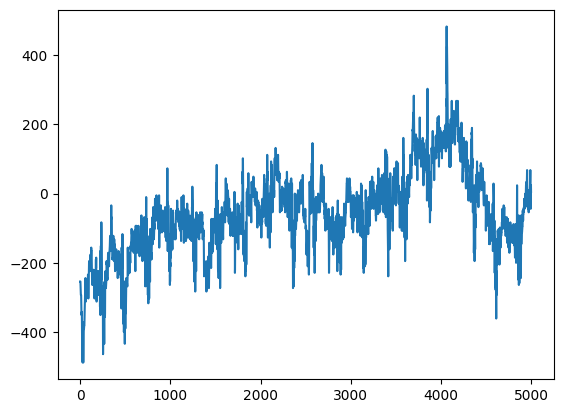

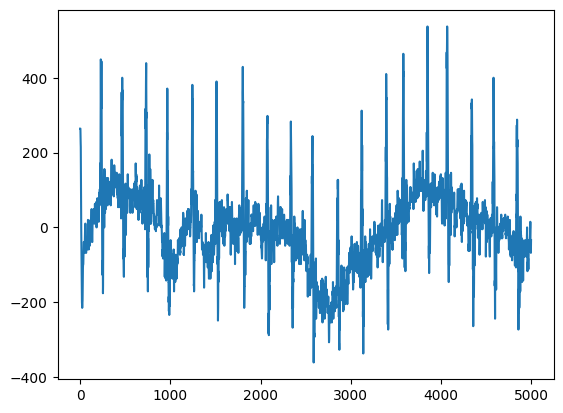

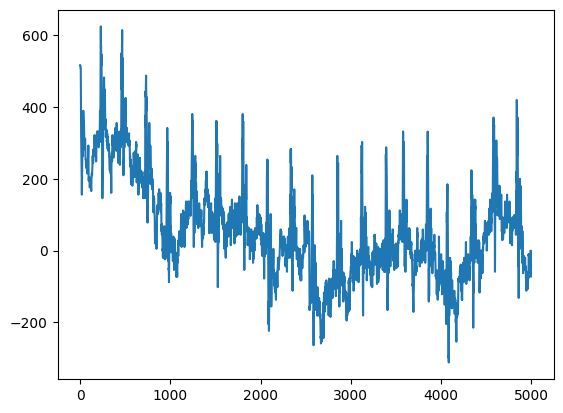

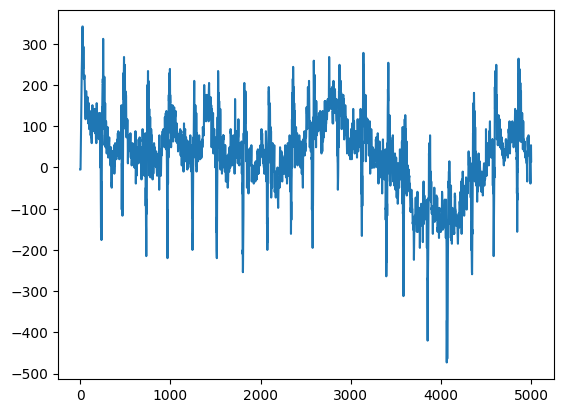

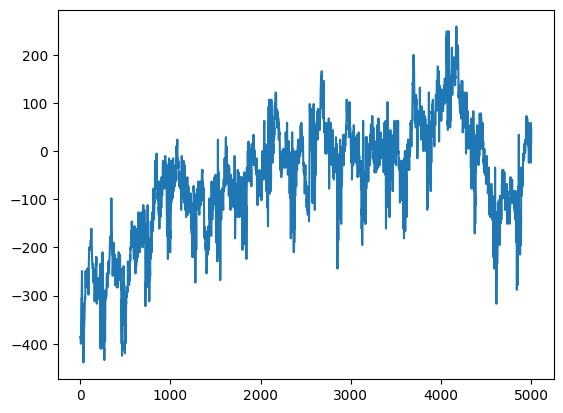

...

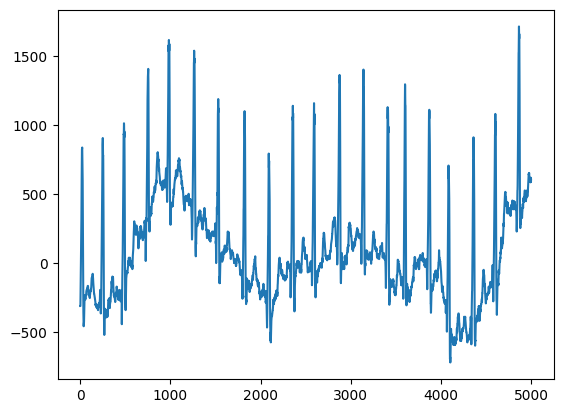

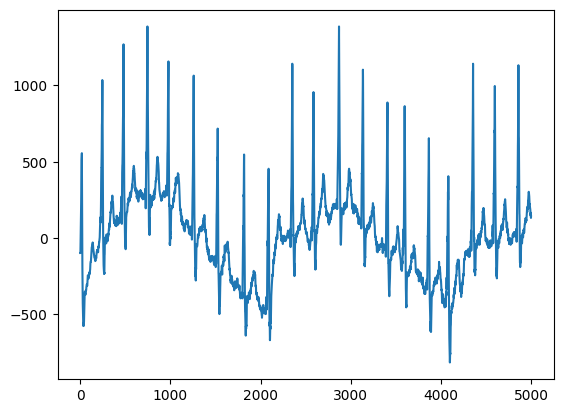

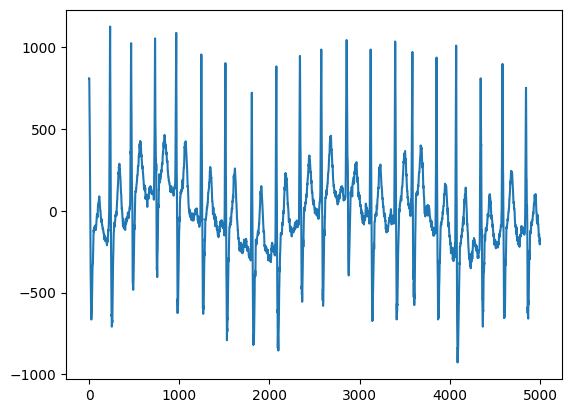

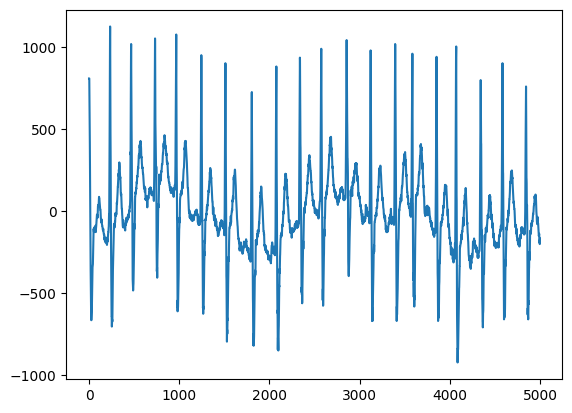

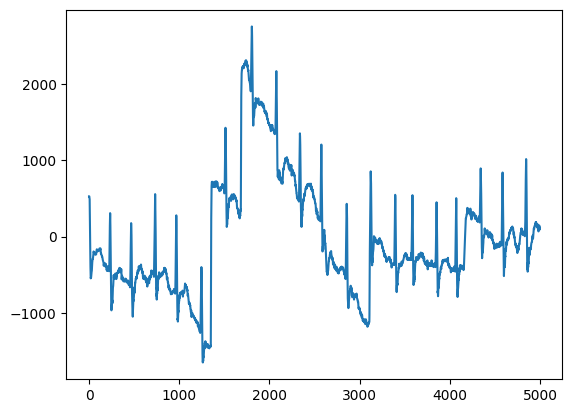

In [3]:
mat = loadmat(f'/home/karansingh/Documents/summer-term/KARAN_ECG/data_prep/data/a-large-scale-12-lead-electrocardiogram-database-for-arrhythmia-study-1.0.0/WFDBRecords/01/010/JS00001.mat')
for  i in range(12):
    plt.plot(mat['val'][i])
    plt.show()

In [4]:
import numpy as np
from sklearn.preprocessing import StandardScaler
from scipy.special import legendre


In [19]:
import math
def superposition(data):
    scale = StandardScaler()
    
def superposition(data: np.ndarray):# it will create super position of 12 lead ecg data 
    """
    This function takes a 5000 * 12 lead data and returns the superposition of the data.
    superpostion matrix multiplied by legendre(j+1)(x) we get the j-th column of the data matrix 
    or we can say the jth lead of the ecg data
    """
    scale=StandardScaler()
    # making each colum of 5000 datapoint should be in
    scaled = scale.fit_transform(data)# normal distribution of each column of the data matrix # feature scaling
    sum=np.zeros((5000,5000))
    x = np.linspace(-1,1,5000)
    for i in range(data.shape[1]):
        leg=legendre(i+1)(x)
        norm=np.linalg.norm(leg)
        sum=sum+np.outer(data[:,i],#data is in shaPE OF 5000xDATA.shape[1] AN SHAPE[1] MEANS THE NUMBER OF COLUMNS
                         leg#legendre polinomial of order i+1 apllied to x p_n applies to matrix x
                         )/norm
        #outer product of the i-th column of the data matrix and the i-th legendre polynomial
        
    
    return sum



def coarse_grain(data,f):
    """ 
    This function takes a 2D numpy array and an integer f as input and returns the coarse grained image of the data.
    which means that the data is divided into fxf blocks and the mean of each block is calculated and stored in a new matrix.
    or we can say we reduce the resolution of the image by a factor of f"""
    img = superposition(data)#superposition of the data

    s1=np.zeros((int(img.shape[0]/f)#shape[0] is the number of rows
                 ,int(img.shape[1]/f))#shape[1] is the number of columns
                 ) # Coarse grained image'

    for i in range(s1.shape[0]):# s1 is zero matrix of shape[0] rows and shape[1] columns
        for j in range(s1.shape[1]):
            s1[i,j]=np.mean(img[i*f:i*f+f,j*f:j*f+f]) # changing the value of the s1 zero matrix to the mean of the fxf block of the img matrix

    return s1

def normalize_matrix(matrix):
    """take input as 500*12 or a person report and return the normalized matrix 
    >>>sum of square of all the elements of the norm_matrix is 1"""
    
    matrix_norm = np.linalg.norm(matrix, 'fro')#frobenius norm is the square root of the sum of the absolute squares of its elements
                                                # works for 2d arrays
    if np.isnan(matrix_norm):# is NAN not a number 
        #it will return a matrix of zeros of the same shape as the input matrix
        return np.zeros_like(matrix)
    else:
        normalized_matrix = matrix / matrix_norm
        return normalized_matrix


In [126]:
js02=np.transpose(mat['val'])
# js02_norm=normalize_matrix(js02)
# js02_norm=js02
cc = superposition(js02_norm)
# transform the all value off cc to the range of 0 to 1
# cc = (cc - cc.min()) / (cc.max() - cc.min())

print(f'shape : {cc.shape}')

cc1 = coarse_grain(js02_norm,100)

shape : (5000, 5000)


In [127]:
cc.max(),cc.min()

(0.06394998594495642, -0.03094147081456434)

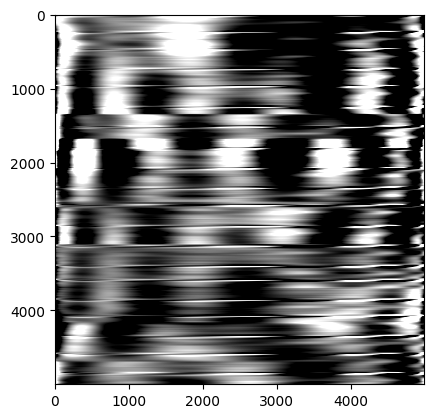

In [135]:
plt.imshow(cc, cmap = 'grey',vmin=cc.min()/15,vmax=cc.max()/15)

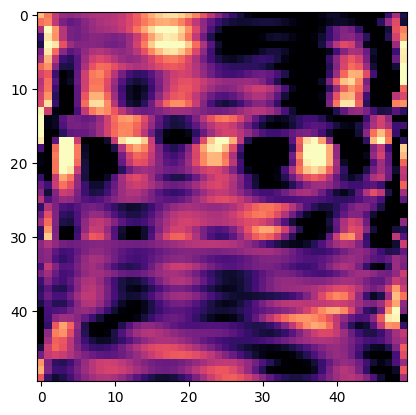

In [50]:
plt.imshow(cc1, cmap = 'magma',vmin=cc.min()/10,vmax=cc.max()/10)

In [84]:
import wfdb
import pandas as pd

In [85]:
def disease_codes(data):
    disease_codes = data[1]['comments'][2].split()[1].split(',')
    return disease_codes
disease_codes_list = pd.DataFrame(pd.read_csv("/home/karansingh/Documents/summer-term/KARAN_ECG/data_prep/data/a-large-scale-12-lead-electrocardiogram-database-for-arrhythmia-study-1.0.0/ConditionNames_SNOMED-CT.csv"))

In [99]:
# print full dataframe disease_codes_list
print(disease_codes_list)

   Acronym Name                                     Full Name  Snomed_CT
0          1AVB               1 degree atrioventricular block  270492004
1          2AVB               2 degree atrioventricular block  195042002
2         2AVB1     2 degree atrioventricular block(Type one)   54016002
3         2AVB2     2 degree atrioventricular block(Type two)   28189009
4          3AVB               3 degree atrioventricular block   27885002
..          ...                                           ...        ...
58          SVT                  Supraventricular Tachycardia  426761007
59           AT                            Atrial Tachycardia  713422000
60        AVNRT  Atrioventricular  Node Reentrant Tachycardia  233896004
61         AVRT        Atrioventricular Reentrant Tachycardia  233897008
62        SAAWR       Sinus Atrium to Atrial Wandering Rhythm  195101003

[63 rows x 3 columns]


In [95]:
def disease_names(codes):
    return disease_codes_list.loc[disease_codes_list['Snomed_CT'].isin(codes), 'Acronym Name'].values

In [97]:
disease_names([195101003,233897008])

array(['WAVN', 'AVRT', 'SAAWR'], dtype=object)

In [ ]:
disease_codes_list["Acronym Name"].iloc[]

In [107]:
import random
random.seed(42)

numbers = random.sample(range(11, 91), 12)

## img using legendre polinomial

In [136]:
import matplotlib.pyplot as plt

fig, axs = plt.subplots(3, 4, figsize=(100,100))  # Create a grid of 3 rows and 4 columns
# 
for i, num in enumerate(numbers):
    mat=loadmat(f'/home/karansingh/Documents/summer-term/KARAN_ECG/data_prep/data/a-large-scale-12-lead-electrocardiogram-database-for-arrhythmia-study-1.0.0/WFDBRecords/01/011/JS001{87+i}.mat')
    data = wfdb.rdsamp(f'/home/karansingh/Documents/summer-term/KARAN_ECG/data_prep/data/a-large-scale-12-lead-electrocardiogram-database-for-arrhythmia-study-1.0.0/WFDBRecords/01/011/JS001{87+i}')#
    js = np.transpose(mat['val'])
    js_norm = normalize_matrix(js)
    cc = superposition_sine(js_norm)*1000
    # cc1 = coarse_grain(js_norm,100)
    row = i // 4  # Determine the row of the subplot
    col = i % 4   # Determine the column of the subplot
    axs[row, col].set_title(f"JS0000{1+i} \n diseases : {disease_names(list(map(int,disease_codes(data))))},\n min : {cc.min()},max : {cc.max()}\n,abs_mean : {np.abs(cc).mean()}.\n mean : {cc.mean()}")
    axs[row, col].imshow(cc, cmap = 'magma',vmin=cc.min()/10,vmax=cc.max()/10)
    # print(cc.max(),cc.min())

plt.tight_layout()  # Adjust the layout to minimize overlap
plt.show()

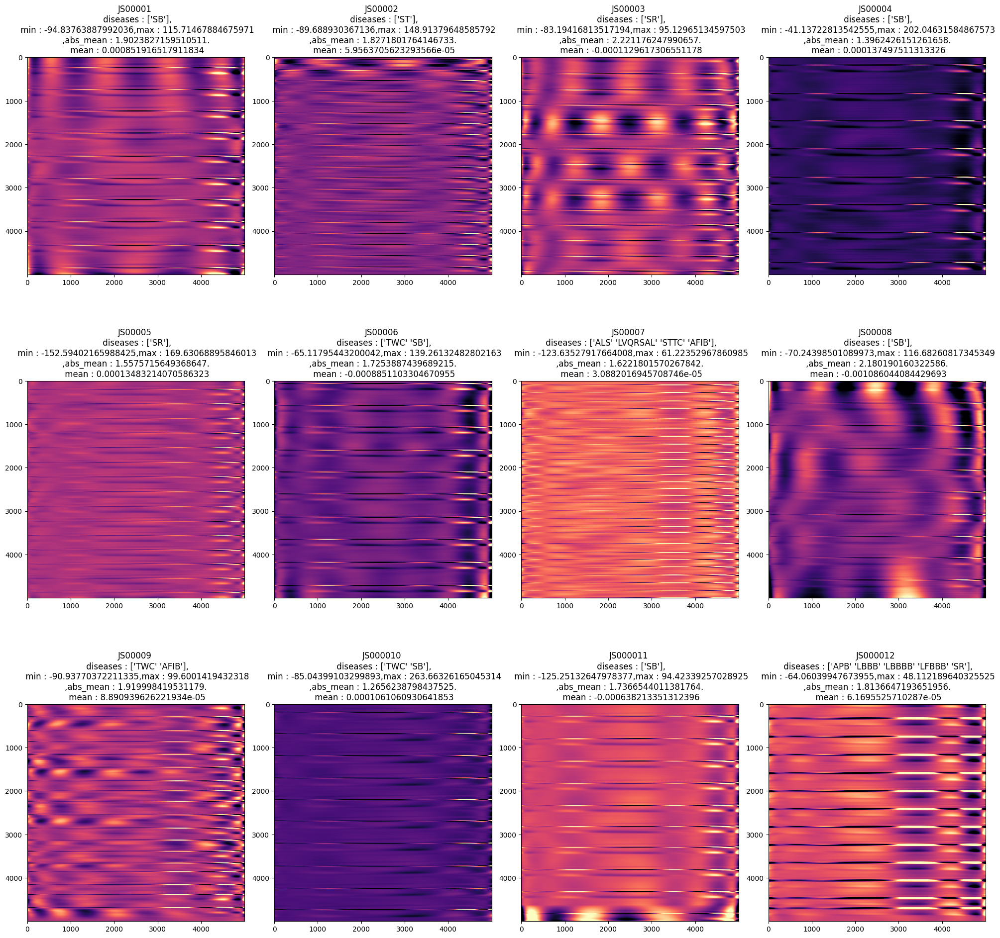

In [138]:
import matplotlib.pyplot as plt

fig, axs = plt.subplots(3, 4, figsize=(20,20))  # Create a grid of 3 rows and 4 columns
# 
for i, num in enumerate(numbers):
    mat=loadmat(f'/home/karansingh/Documents/summer-term/KARAN_ECG/data_prep/data/a-large-scale-12-lead-electrocardiogram-database-for-arrhythmia-study-1.0.0/WFDBRecords/01/011/JS001{70+i}.mat')
    data = wfdb.rdsamp(f'/home/karansingh/Documents/summer-term/KARAN_ECG/data_prep/data/a-large-scale-12-lead-electrocardiogram-database-for-arrhythmia-study-1.0.0/WFDBRecords/01/011/JS001{70+i}')#
    js = np.transpose(mat['val'])
    js_norm = normalize_matrix(js)
    cc = superposition(js_norm)*1000
    # cc1 = coarse_grain(js_norm,100)
    row = i // 4  # Determine the row of the subplot
    col = i % 4   # Determine the column of the subplot
    axs[row, col].set_title(f"JS0000{1+i} \n diseases : {disease_names(list(map(int,disease_codes(data))))},\n min : {cc.min()},max : {cc.max()}\n,abs_mean : {np.abs(cc).mean()}.\n mean : {cc.mean()}")
    axs[row, col].imshow(cc, cmap = 'magma',vmin=cc.min()/10,vmax=cc.max()/10)
    # print(cc.max(),cc.min())

plt.tight_layout()  # Adjust the layout to minimize overlap
plt.show()

## using sin 

In [267]:
from numpy import sin as sin

def superposition_sine(data: np.ndarray):# it will create super position of 12 lead ecg data 
    """
    This function takes a 5000 * 12 lead data and returns the superposition of the data.
    superpostion matrix multiplied by legendre(j+1)(x) we get the j-th column of the data matrix 
    or we can say the jth lead of the ecg data
    """
    scale=StandardScaler()
    # making each colum of 5000 datapoint should be in
    scaled = scale.fit_transform(data)# normal distribution of each column of the data matrix # feature scaling
    sum=np.zeros((5000,5000))
    x = np.linspace(-math.pi,math.pi,5000)
    for i in range(data.shape[1]):
        sine=sin((i+1)*x)
        norm=np.linalg.norm(sine)
        sum=sum+np.outer(data[:,i],#data is in shaPE OF 5000xDATA.shape[1] AN SHAPE[1] MEANS THE NUMBER OF COLUMNS
                         sine#legendre polinomial of order i+1 apllied to x p_n applies to matrix x
                         )/norm
        #outer product of the i-th column of the data matrix and the i-th legendre polynomial
    return sum
def coarse_grain_sine(data,f):
    """ 
    This function takes a 2D numpy array and an integer f as input and returns the coarse grained image of the data.
    which means that the data is divided into fxf blocks and the mean of each block is calculated and stored in a new matrix.
    or we can say we reduce the resolution of the image by a factor of f"""
    img = superposition_sine(data)#superposition of the data

    s1=np.zeros((int(img.shape[0]/f)#shape[0] is the number of rows
                 ,int(img.shape[1]/f))#shape[1] is the number of columns
                 ) # Coarse grained image'

    for i in range(s1.shape[0]):# s1 is zero matrix of shape[0] rows and shape[1] columns
        for j in range(s1.shape[1]):
            s1[i,j]=np.mean(img[i*f:i*f+f,j*f:j*f+f]) # changing the value of the s1 zero matrix to the mean of the fxf block of the img matrix

    return s1

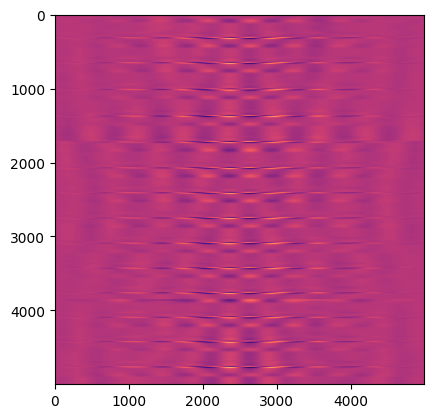

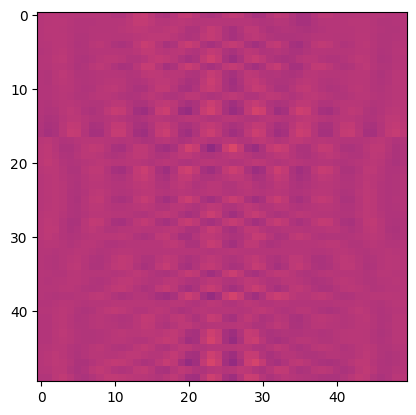

In [268]:

mat=loadmat(f'/home/karansingh/Documents/summer-term/KARAN_ECG/data_prep/data/a-large-scale-12-lead-electrocardiogram-database-for-arrhythmia-study-1.0.0/WFDBRecords/01/011/JS001{87}.mat')
data = wfdb.rdsamp(f'/home/karansingh/Documents/summer-term/KARAN_ECG/data_prep/data/a-large-scale-12-lead-electrocardiogram-database-for-arrhythmia-study-1.0.0/WFDBRecords/01/011/JS001{87}')#
js = np.transpose(mat['val'])
js_norm = normalize_matrix(js)
cc = superposition_sine(js_norm)

cc1 = coarse_grain_sine(js_norm,100)

plt.imshow(cc, cmap = 'magma',vmin=cc.min(),vmax=cc.max())
plt.show()
plt.imshow(cc1, cmap = 'magma',vmin=cc.min(),vmax=cc.max())
plt.show()

In [269]:
cc.max(),cc.min()

(0.002578423310635527, -0.002578423310635527)

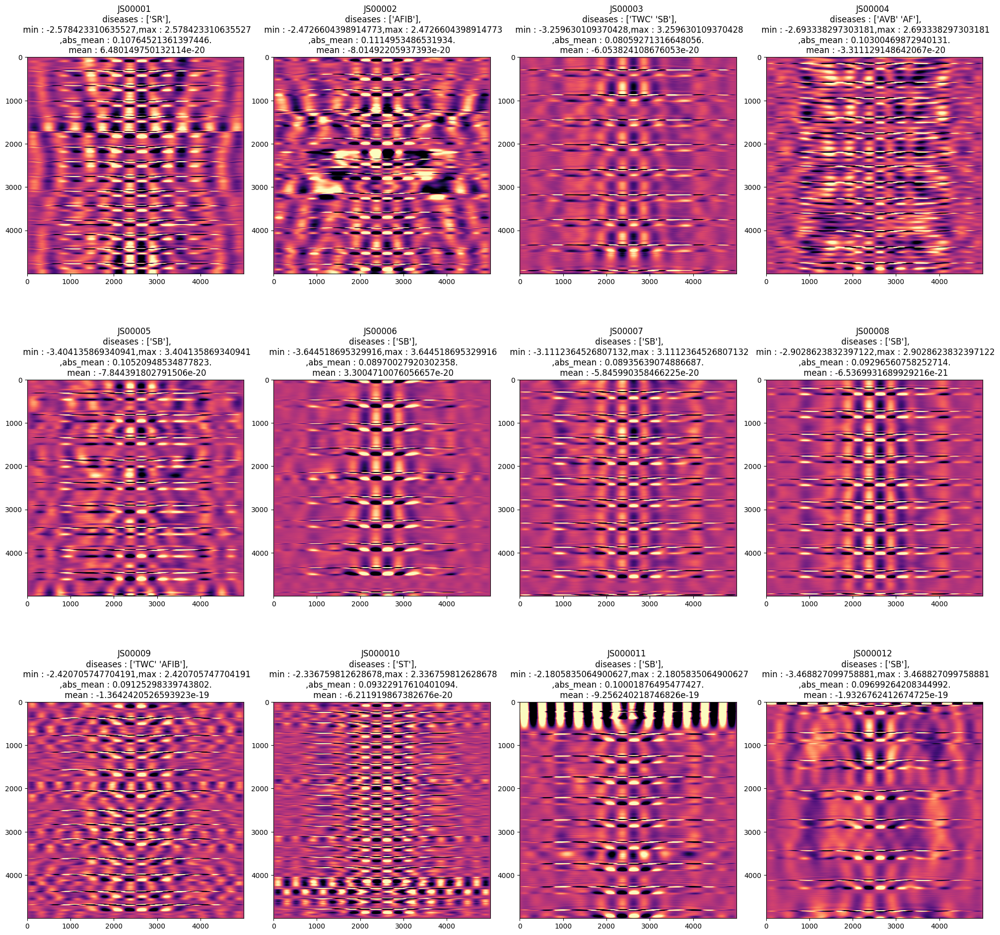

In [273]:
import matplotlib.pyplot as plt

fig, axs = plt.subplots(3, 4, figsize=(20,20))  # Create a grid of 3 rows and 4 columns
# 
for i, num in enumerate(numbers):
    mat=loadmat(f'/home/karansingh/Documents/summer-term/KARAN_ECG/data_prep/data/a-large-scale-12-lead-electrocardiogram-database-for-arrhythmia-study-1.0.0/WFDBRecords/01/011/JS001{87+i}.mat')
    data = wfdb.rdsamp(f'/home/karansingh/Documents/summer-term/KARAN_ECG/data_prep/data/a-large-scale-12-lead-electrocardiogram-database-for-arrhythmia-study-1.0.0/WFDBRecords/01/011/JS001{87+i}')#
    js = np.transpose(mat['val'])
    js_norm = normalize_matrix(js)
    cc = superposition_sine(js_norm)*1000
    # cc1 = coarse_grain(js_norm,100)
    row = i // 4  # Determine the row of the subplot
    col = i % 4   # Determine the column of the subplot
    axs[row, col].set_title(f"JS0000{1+i} \n diseases : {disease_names(list(map(int,disease_codes(data))))},\n min : {cc.min()},max : {cc.max()}\n,abs_mean : {np.abs(cc).mean()}.\n mean : {cc.mean()}")
    axs[row, col].imshow(cc, cmap = 'magma',vmin=cc.min()/10,vmax=cc.max()/10)
    # print(cc.max(),cc.min())

plt.tight_layout()  # Adjust the layout to minimize overlap
plt.show()

#### cg 50

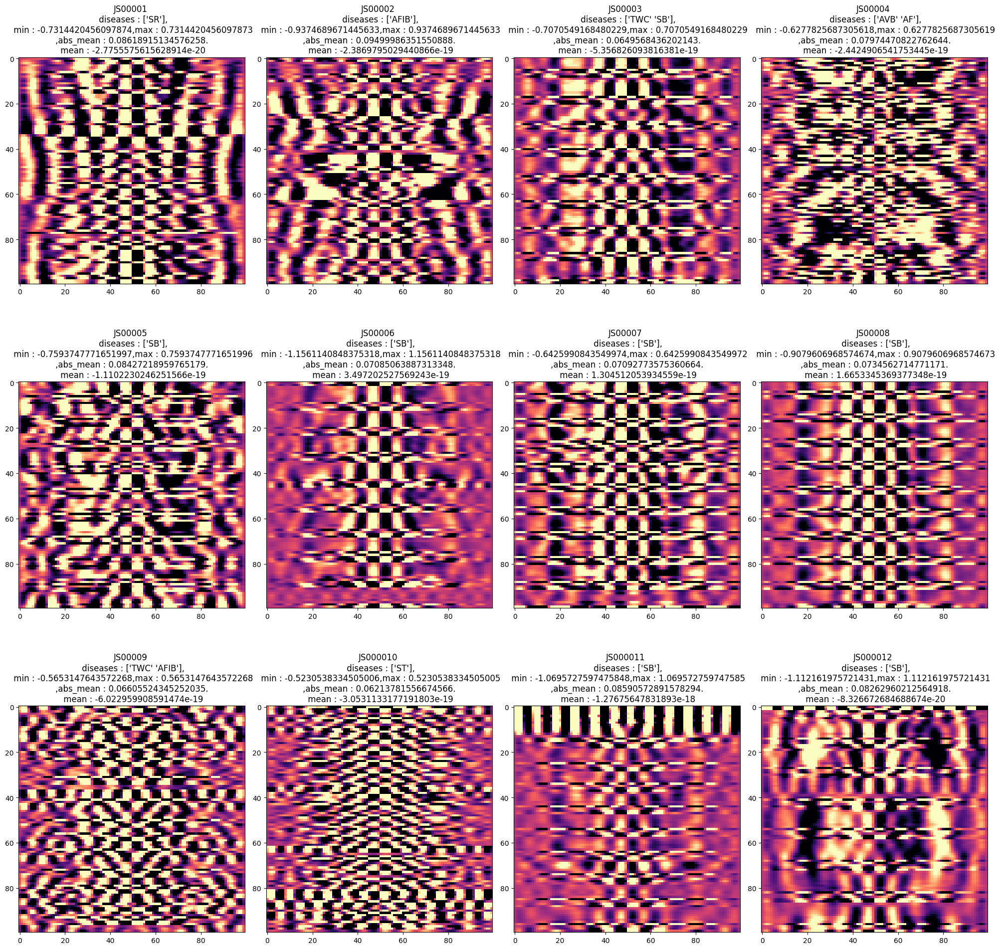

In [270]:

fig, axs = plt.subplots(3, 4, figsize=(20,20))  # Create a grid of 3 rows and 4 columns
# 
for i, num in enumerate(numbers):
    mat=loadmat(f'/home/karansingh/Documents/summer-term/KARAN_ECG/data_prep/data/a-large-scale-12-lead-electrocardiogram-database-for-arrhythmia-study-1.0.0/WFDBRecords/01/011/JS001{87+i}.mat')
    data = wfdb.rdsamp(f'/home/karansingh/Documents/summer-term/KARAN_ECG/data_prep/data/a-large-scale-12-lead-electrocardiogram-database-for-arrhythmia-study-1.0.0/WFDBRecords/01/011/JS001{87+i}')#
    js = np.transpose(mat['val'])
    js_norm = normalize_matrix(js)
    cc = coarse_grain_sine(js_norm,50)*1000
    # cc1 = coarse_grain(js_norm,100)
    row = i // 4  # Determine the row of the subplot
    col = i % 4   # Determine the column of the subplot
    axs[row, col].set_title(f"JS0000{1+i} \n diseases : {disease_names(list(map(int,disease_codes(data))))},\n min : {cc.min()},max : {cc.max()}\n,abs_mean : {np.abs(cc).mean()}.\n mean : {cc.mean()}")
    axs[row, col].imshow(cc, cmap = 'magma',vmin=cc.min()/10,vmax=cc.max()/10)
    # print(cc.max(),cc.min())

plt.tight_layout()  # Adjust the layout to minimize overlap
plt.show()

#### cg_100

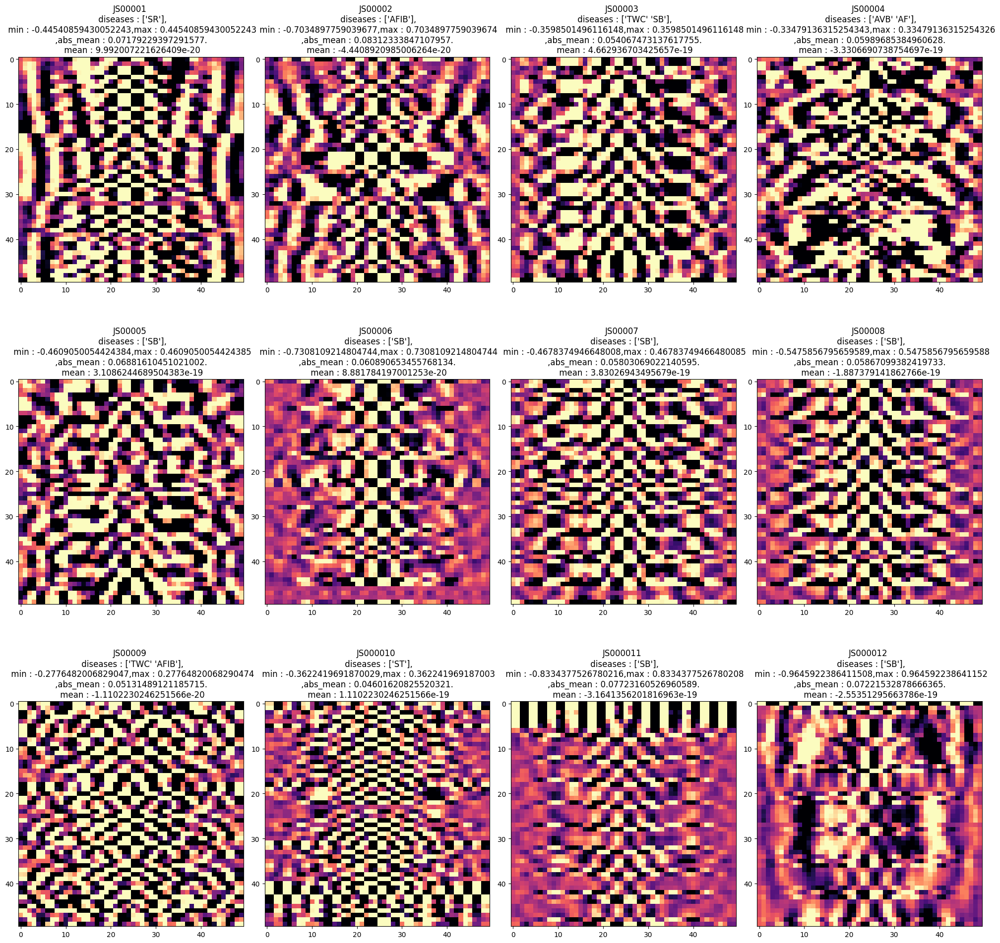

In [272]:

fig, axs = plt.subplots(3, 4, figsize=(20,20))  # Create a grid of 3 rows and 4 columns
# 
for i, num in enumerate(numbers):
    mat=loadmat(f'/home/karansingh/Documents/summer-term/KARAN_ECG/data_prep/data/a-large-scale-12-lead-electrocardiogram-database-for-arrhythmia-study-1.0.0/WFDBRecords/01/011/JS001{87+i}.mat')
    data = wfdb.rdsamp(f'/home/karansingh/Documents/summer-term/KARAN_ECG/data_prep/data/a-large-scale-12-lead-electrocardiogram-database-for-arrhythmia-study-1.0.0/WFDBRecords/01/011/JS001{87+i}')#
    js = np.transpose(mat['val'])
    js_norm = normalize_matrix(js)
    cc = coarse_grain_sine(js_norm,100)*1000
    # cc1 = coarse_grain(js_norm,100)
    row = i // 4  # Determine the row of the subplot
    col = i % 4   # Determine the column of the subplot
    axs[row, col].set_title(f"JS0000{1+i} \n diseases : {disease_names(list(map(int,disease_codes(data))))},\n min : {cc.min()},max : {cc.max()}\n,abs_mean : {np.abs(cc).mean()}.\n mean : {cc.mean()}")
    axs[row, col].imshow(cc, cmap = 'magma',vmin=cc.min()/10,vmax=cc.max()/10)
    # print(cc.max(),cc.min())

plt.tight_layout()  # Adjust the layout to minimize overlap
plt.show()